### Import Libraries

In [1]:
import warnings
warnings.filterwarnings('ignore')

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

### Configurations

In [2]:
pd.set_option('display.max_rows', 100)
pd.set_option('display.max_columns', 100)

### UDFs

In [3]:
def count_plot(x, dataframe, ax=None, **kwargs):
    if len(kwargs)==1 and kwargs['mode']=='horizontal':
        sns.countplot(y=x, data=dataframe, ax=ax, order=dataframe[x].value_counts().index)
    else:
        sns.countplot(x=x, data=dataframe, ax=ax, order=dataframe[x].value_counts().index)
    plt.box(False)
    return None

    
def pie_plot(df_col, fig_size, title):
    fig, ax = plt.subplots(figsize=fig_size)
    ax.pie(df_col.values, autopct='%1.2f%%', shadow=False, startangle=90)
    ax.axis('equal')
    plt.legend(labels=df_col.index, bbox_to_anchor=(1.05, 1))
    plt.title(title)
    plt.show()
    return None


def stacked_vBar_plot(dataframe, value, index, column, xlabel, fig_size, scale='linear', with_percent=True):
    
    df_1 = dataframe.pivot_table(values=[value], index=[index], columns=[column], aggfunc=len, margins=True)
    df_1_percent = df_1.div(df_1.iloc[:,-1], axis=0).mul(100, axis=0).round(2)
    df_2_percent = df_1_percent.iloc[:, :-1].drop('All')
    
    columns = df_2_percent.columns.levels[1].tolist()
    columns.remove('All')
    
    ax = df_2_percent.plot.bar(stacked=True)
    ax.figure.set_size_inches(fig_size)
    ax.grid(False)
    plt.legend(labels=columns, bbox_to_anchor=(1.05, 1), title='NPS Type')
    plt.xlabel(xlabel)
    plt.ylabel('%GT Count of NPS_Type')
    
    if with_percent:
        # Add this loop to add the annotations
        for p in ax.patches:
            width, height = p.get_width(), p.get_height()
            x, y = p.get_xy() 
            ax.annotate('{:.2f}%'.format(height), (x + width/8, y + height/2))
    plt.box(False)
    plt.show()
    return None


def pdf_distribution_plots(df, features, target, fig_size):
    nrow = int((len(features)/3) + len(features)%3)
    
    t0 = df.loc[df[target] == 0]
    t1 = df.loc[df[target] == 1]

    sns.set_style('whitegrid')
    fig = plt.figure(figsize=fig_size)

    for indx, feature in enumerate(features):
        ax = fig.add_subplot(nrow, 3, indx+1)
        sns.kdeplot(t0[feature], label="0", legend=True)
        sns.kdeplot(t1[feature], label="1", legend=True)
        ax.set_ylabel('Density', fontsize=12)
        ax.set_xlabel(feature, fontsize=12)
        ax.tick_params(axis='both', which='major', labelsize=15)
        ax.legend(loc='best')
    
    plt.subplots_adjust(left=None, bottom=None, right=None, top=None,wspace= 0.3, hspace=0.5)
    plt.show()
    return None


def clipping(dataframe, num_cols):
    df_copy = dataframe.copy()
    for col in num_cols:
        p25 = np.percentile(df_copy[col], 25)
        p75 = np.percentile(df_copy[col], 75)
        iqr = p75 - p25
        df_copy[col] = np.clip(df_copy[col], a_min=np.floor((p25 - 1.5*iqr)), a_max=np.ceil((p75 + 1.5*iqr)))
    return df_copy


def get_category(df, col, binsnum, labels, qcut = False):
    if qcut:
        localdf = pd.qcut(df[col], q = binsnum, labels = labels) # quantile cut
    else:
        localdf = pd.cut(df[col], bins = binsnum, labels = labels) # equal-length cut
        
    localdf = pd.DataFrame(localdf)
    name = col + '_CAT'
    localdf[name] = localdf[col]
    df = df.join(localdf[name])
    df[name] = df[name].astype(object)
    return df

### Load Data

In [4]:
train_df = pd.read_csv('../data/icr-identify-age-related-conditions/train.csv')

train_df.head()

,Id,AB,AF,AH,AM,AR,AX,AY,AZ,BC,BD,BN,BP,BQ,BR,BZ,CB,CC,CD,CF,CH,CL,CR,CS,CU,CW,DA,DE,DF,DH,DI,DL,DN,DU,DV,DY,EB,EE,EG,EH,EJ,EL,EP,EU,FC,FD,FE,FI,FL,FR,FS,GB,GE,GF,GH,GI,GL,Class
0,000ff2bfdfe9,0.209377,3109.03329,85.200147,22.394407,8.138688,0.699861,0.025578,9.812214,5.555634,4126.58731,22.5984,175.638726,152.707705,823.928241,257.432377,47.223358,0.563481,23.387600,4.851915,0.023482,1.050225,0.069225,13.784111,1.302012,36.205956,69.08340,295.570575,0.23868,0.284232,89.245560,84.31664,29.657104,5.310690,1.74307,23.187704,7.294176,1.987283,1433.166750,0.949104,B,30.879420,78.526968,3.828384,13.394640,10.265073,9028.291921,3.583450,7.298162,1.73855,0.094822,11.339138,72.611063,2003.810319,22.136229,69.834944,0.120343,1
1,007255e47698,0.145282,978.76416,85.200147,36.968889,8.138688,3.632190,0.025578,13.517790,1.229900,5496.92824,19.4205,155.868030,14.754720,51.216883,257.432377,30.284345,0.484710,50.628208,6.085041,0.031442,1.113875,1.117800,28.310953,1.357182,37.476568,70.79836,178.553100,0.23868,0.363489,110.581815,75.74548,37.532000,0.005518,1.74307,17.222328,4.926396,0.858603,1111.287150,0.003042,A,109.125159,95.415086,52.260480,17.175984,0.296850,6785.003474,10.358927,0.173229,0.49706,0.568932,9.292698,72.611063,27981.562750,29.135430,32.131996,21.978000,0
2,013f2bd269f5,0.470030,2635.10654,85.200147,32.360553,8.138688,6.732840,0.025578,12.824570,1.229900,5135.78024,26.4825,128.988531,219.320160,482.141594,257.432377,32.563713,0.495852,85.955376,5.376488,0.036218,1.050225,0.700350,39.364743,1.009611,21.459644,70.81970,321.426625,0.23868,0.210441,120.056438,65.46984,28.053464,1.289739,1.74307,36.861352,7.813674,8.146651,1494.076488,0.377208,B,109.125159,78.526968,5.390628,224.207424,8.745201,8338.906181,11.626917,7.709560,0.97556,1.198821,37.077772,88.609437,13676.957810,28.022851,35.192676,0.196941,0
3,043ac50845d5,0.252107,3819.65177,120.201618,77.112203,8.138688,3.685344,0.025578,11.053708,1.229900,4169.67738,23.6577,237.282264,11.050410,661.518640,257.432377,15.201914,0.717882,88.159360,2.347652,0.029054,1.400300,0.636075,41.116960,0.722727,21.530392,47.27586,196.607985,0.23868,0.292431,139.824570,71.57120,24.354856,2.655345,1.74307,52.003884,7.386060,3.813326,15691.552180,0.614484,B,31.674357,78.526968,31.323372,59.301984,7.884336,10965.766040,14.852022,6.122162,0.49706,0.284466,18.529584,82.416803,2094.262452,39.948656,90.493248,0.155829,0
4,044fb8a146ec,0.380297,3733.04844,85.200147,14.103738,8.138688,3.942255,0.054810,3.396778,102.151980,5728.73412,24.0108,324.546318,149.717165,6074.859475,257.432377,82.213495,0.536467,72.644264,30.537722,0.025472,1.050225,0.693150,31.724726,0.827550,34.415360,74.06532,200.178160,0.23868,0.207708,97.920120,52.83888,26.019912,1.144902,1.74307,9.064856,7.350720,3.490846,1403.656300,0.164268,B,109.125159,91.994825,51.141336,29.102640,4.274640,16198.049590,13.666727,8.153058,48.50134,0.121914,16.408728,146.109943,8524.370502,45.381316,36.262628,0.096614,1


### Basic Statistics

In [5]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 617 entries, 0 to 616
Data columns (total 58 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Id      617 non-null    object 
 1   AB      617 non-null    float64
 2   AF      617 non-null    float64
 3   AH      617 non-null    float64
 4   AM      617 non-null    float64
 5   AR      617 non-null    float64
 6   AX      617 non-null    float64
 7   AY      617 non-null    float64
 8   AZ      617 non-null    float64
 9   BC      617 non-null    float64
 10  BD      617 non-null    float64
 11  BN      617 non-null    float64
 12  BP      617 non-null    float64
 13  BQ      557 non-null    float64
 14  BR      617 non-null    float64
 15  BZ      617 non-null    float64
 16  CB      615 non-null    float64
 17  CC      614 non-null    float64
 18  CD      617 non-null    float64
 19  CF      617 non-null    float64
 20  CH      617 non-null    float64
 21  CL      617 non-null    float64
 22  CR

<AxesSubplot:>

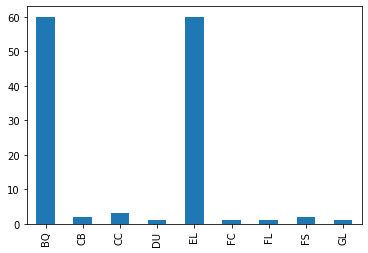

In [6]:
# Missing data
train_df.isna().sum()[train_df.isna().sum()>0].plot(kind='bar')

In [7]:
# Missing data
total = train_df.isnull().sum().sort_values(ascending=False)
percent = (train_df.isnull().sum()/train_df.isnull().count()).sort_values(ascending=False)
missing_data = pd.concat([total, percent], axis=1, keys=['Total', 'Percent'])
missing_data.head(15)

,Total,Percent
EL,60,0.097245
BQ,60,0.097245
CC,3,0.004862
FS,2,0.003241
CB,2,0.003241
FL,1,0.001621
FC,1,0.001621
DU,1,0.001621
GL,1,0.001621
EE,0,0.000000


In [8]:
train_df.drop(columns=['Id']).describe(exclude=['object']).applymap('{:,.2f}'.format).transpose()

,count,mean,std,min,25%,50%,75%,max
AB,617.00,0.48,0.47,0.08,0.25,0.35,0.56,6.16
AF,617.00,"3,502.01","2,300.32",192.59,"2,197.35","3,120.32","4,361.64","28,688.19"
AH,617.00,118.62,127.84,85.20,85.20,85.20,113.74,"1,910.12"
AM,617.00,38.97,69.73,3.18,12.27,20.53,39.14,630.52
AR,617.00,10.13,10.52,8.14,8.14,8.14,8.14,178.94
AX,617.00,5.55,2.55,0.70,4.13,5.03,6.43,38.27
AY,617.00,0.06,0.42,0.03,0.03,0.03,0.04,10.32
AZ,617.00,10.57,4.35,3.40,8.13,10.46,12.97,38.97
BC,617.00,8.05,65.17,1.23,1.23,1.23,5.08,"1,463.69"
BD,617.00,"5,350.39","3,021.33","1,693.62","4,155.70","4,997.96","6,035.89","53,060.60"


### Univariate Analysis

In [9]:
num_feat = train_df.drop(columns=['Id', 'Class']).select_dtypes(exclude=['object']).columns.tolist()
print(f'Numerical Features: {num_feat}')

cat_feat = train_df.drop(columns=['Id', 'Class']).select_dtypes(include=['object']).columns.tolist()
print(f'Categorical Features: {cat_feat}')

Numerical Features: ['AB', 'AF', 'AH', 'AM', 'AR', 'AX', 'AY', 'AZ', 'BC', 'BD ', 'BN', 'BP', 'BQ', 'BR', 'BZ', 'CB', 'CC', 'CD ', 'CF', 'CH', 'CL', 'CR', 'CS', 'CU', 'CW ', 'DA', 'DE', 'DF', 'DH', 'DI', 'DL', 'DN', 'DU', 'DV', 'DY', 'EB', 'EE', 'EG', 'EH', 'EL', 'EP', 'EU', 'FC', 'FD ', 'FE', 'FI', 'FL', 'FR', 'FS', 'GB', 'GE', 'GF', 'GH', 'GI', 'GL']
Categorical Features: ['EJ']


#### Class Distribution

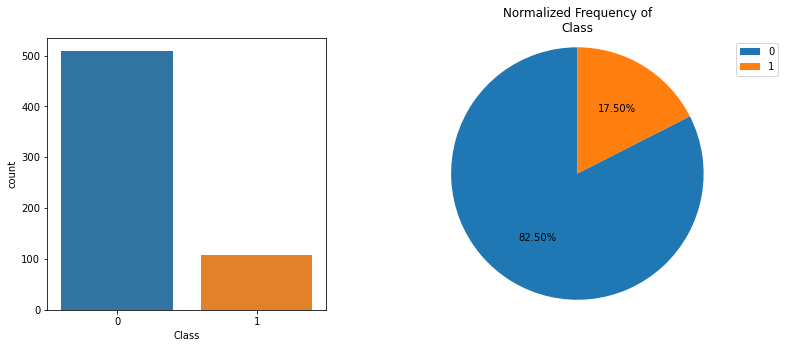

In [10]:
feature = 'Class'
unique_id = 'Id'

fig1, axes1 = plt.subplots(1, 2, figsize=(12,5))
fig1.subplots_adjust(hspace=0.4, wspace=0.4)

count_plot(x=feature, dataframe=train_df, ax=axes1[0])

grouped_df = train_df.groupby([feature])[[unique_id]].count()
grouped_df.rename(columns={unique_id: 'Count'}, inplace=True)
grouped_df['Percentage'] = round(100*grouped_df['Count']/grouped_df['Count'].sum(), 2)
grouped_df.sort_values(by=['Percentage'], ascending=False, inplace=True)

axes1[1].pie(grouped_df['Count'].values, autopct='%1.2f%%', shadow=False, startangle=90)
axes1[1].axis('equal')
axes1[1].legend(labels=grouped_df['Count'].index, bbox_to_anchor=(1.05, 1))
axes1[1].title.set_text('Normalized Frequency of\n{}'.format(feature))

plt.show()

#### Distributions of Categorical Features

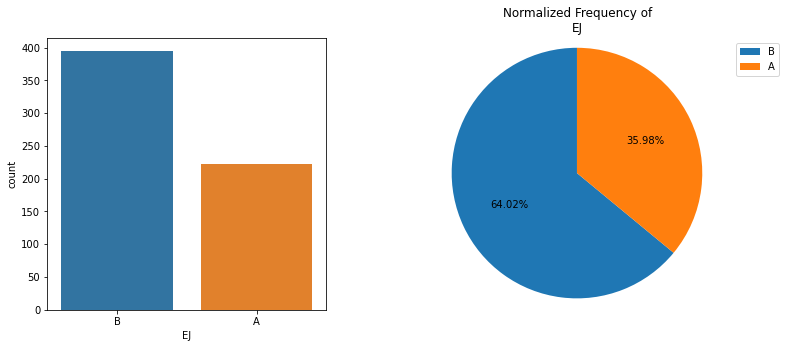

In [11]:
feature = 'EJ'
unique_id = 'Id'

fig1, axes1 = plt.subplots(1, 2, figsize=(12,5))
fig1.subplots_adjust(hspace=0.4, wspace=0.4)

count_plot(x=feature, dataframe=train_df, ax=axes1[0])

grouped_df = train_df.groupby([feature])[[unique_id]].count()
grouped_df.rename(columns={unique_id: 'Count'}, inplace=True)
grouped_df['Percentage'] = round(100*grouped_df['Count']/grouped_df['Count'].sum(), 2)
grouped_df.sort_values(by=['Percentage'], ascending=False, inplace=True)

axes1[1].pie(grouped_df['Count'].values, autopct='%1.2f%%', shadow=False, startangle=90)
axes1[1].axis('equal')
axes1[1].legend(labels=grouped_df['Count'].index, bbox_to_anchor=(1.05, 1))
axes1[1].title.set_text('Normalized Frequency of\n{}'.format(feature))

plt.show()

#### Distributions of Numerical Features

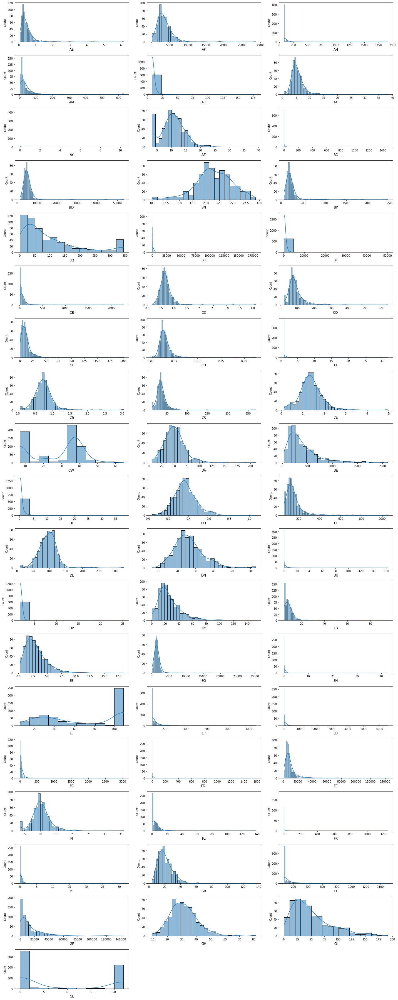

In [12]:
nrow = int((len(num_feat)/3) + len(num_feat)%3)

fig = plt.figure(figsize=(20,50))

for i, feature in enumerate(num_feat):
    ax = fig.add_subplot(nrow, 3, i+1)
    sns.histplot(data=train_df, x=feature, kde=True)
    ax.set_xlabel(feature, fontsize=12)

# Adjust the spacing between subplots
fig.tight_layout()

# Display the plot
plt.show()

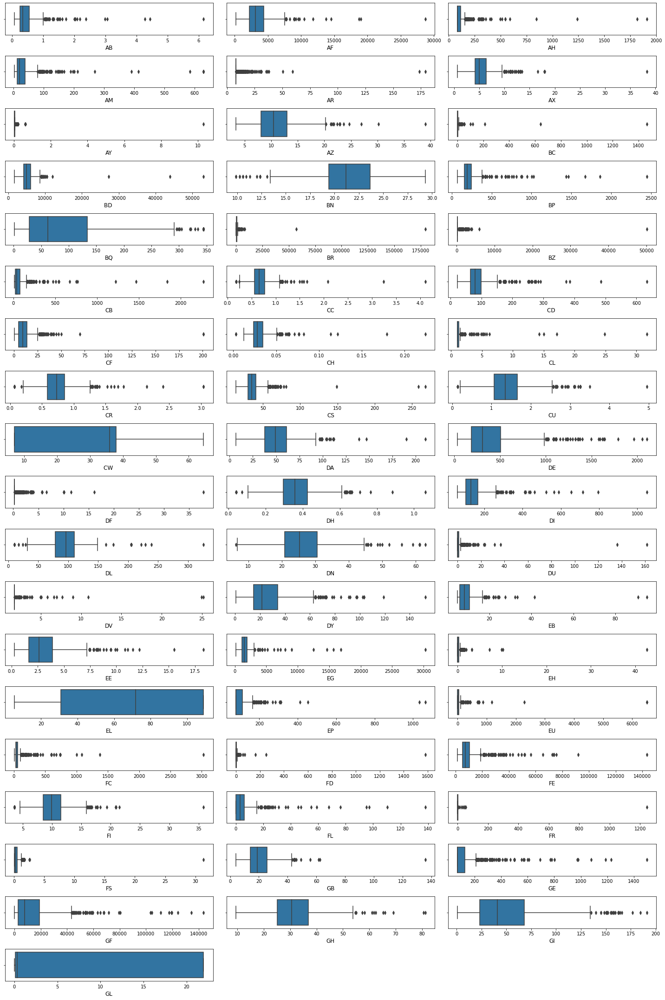

In [13]:
nrow = int((len(num_feat)/3) + len(num_feat)%3)

fig = plt.figure(figsize=(20,30))

for i, feature in enumerate(num_feat):
    ax = fig.add_subplot(nrow, 3, i+1)
    sns.boxplot(data=train_df, x=feature)
    ax.set_xlabel(feature, fontsize=12)

# Adjust the spacing between subplots
fig.tight_layout()

# Display the plot
plt.show()

### Bivariate Analysis

#### Correlation

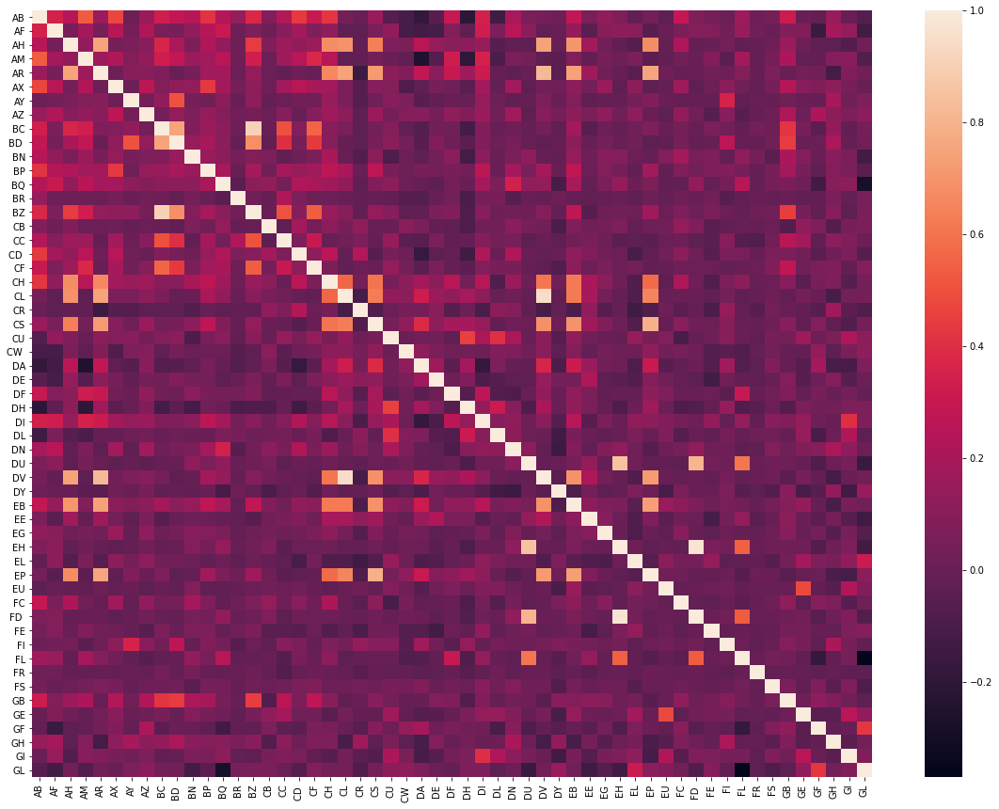

,AB,AF,AH,AM,AR,AX,AY,AZ,BC,BD,BN,BP,BQ,BR,BZ,CB,CC,CD,CF,CH,CL,CR,CS,CU,CW,DA,DE,DF,DH,DI,DL,DN,DU,DV,DY,EB,EE,EG,EH,EL,EP,EU,FC,FD,FE,FI,FL,FR,FS,GB,GE,GF,GH,GI,GL
AB,1.000000,0.350231,0.249246,0.530687,0.157712,0.471912,0.011004,0.158569,0.331736,0.278920,0.246410,0.412869,0.237270,0.148966,0.375898,0.081112,0.233556,0.437661,0.299386,0.426383,0.040467,-0.005741,0.158294,-0.066341,-0.109078,-0.183127,-0.050492,0.299234,-0.204446,0.343071,-0.137980,0.195190,0.059821,0.036950,0.016847,0.279021,0.058040,0.124917,0.072192,-0.023105,0.033086,-0.034322,0.290276,0.067027,0.041684,0.004967,0.169934,0.017990,0.036913,0.318741,0.003327,-0.017192,0.148456,0.002903,-0.061601
AF,0.350231,1.000000,0.044140,0.183961,0.044917,0.248439,0.039417,0.219172,0.058831,0.045430,0.131428,0.241027,0.309300,0.018409,0.067106,0.013128,0.091546,0.181395,0.066975,0.126804,-0.030457,-0.035850,0.054071,0.132456,-0.118106,-0.127525,-0.113353,0.080841,-0.027899,0.330857,0.057947,0.255259,0.110287,-0.018922,-0.006084,0.141196,-0.045524,0.096498,0.116330,0.114897,-0.052378,-0.001646,0.060819,0.088511,0.080458,0.021914,0.148289,0.021009,-0.003108,0.079993,0.076449,-0.159796,0.187105,0.140935,-0.127870
AH,0.249246,0.044140,1.000000,0.128268,0.749794,0.039324,0.055385,0.095627,0.366910,0.209508,0.055154,0.223916,0.131165,0.011948,0.440221,0.077926,0.162371,0.131419,0.164696,0.677612,0.693637,-0.018642,0.632552,0.070736,0.062493,0.260513,0.143512,0.105094,0.109871,0.148272,-0.050009,-0.026802,-0.032162,0.746715,0.002736,0.705110,0.175891,0.027994,-0.023344,-0.067320,0.678742,-0.010162,0.217062,-0.010942,-0.006100,0.035902,-0.022822,-0.009112,0.018328,0.159666,0.011332,-0.029422,-0.037542,-0.073142,0.029175
AM,0.530687,0.183961,0.128268,1.000000,0.175212,0.225382,0.081666,0.131885,0.329658,0.277908,0.158404,0.178260,0.260038,0.011272,0.333209,0.004800,0.160961,0.249581,0.370031,0.250566,-0.029723,-0.026143,0.032254,0.001013,-0.031086,-0.255359,-0.062401,0.321732,-0.202972,0.347550,-0.091830,0.059895,0.038487,-0.036929,-0.040123,0.082645,-0.020696,0.043258,0.010132,0.055216,-0.042153,-0.019131,0.027564,0.002447,0.077170,-0.038974,0.187974,-0.009183,0.040846,0.217443,-0.012176,-0.019639,0.089008,0.100873,-0.079717
AR,0.157712,0.044917,0.749794,0.175212,1.000000,0.011715,0.099947,0.099282,0.073730,-0.002509,0.048671,0.177579,0.184149,0.007044,0.137466,0.009110,-0.021310,0.020578,-0.002361,0.660409,0.745504,-0.153166,0.720853,0.108454,0.076620,0.281715,0.105616,0.301627,0.174468,0.318558,-0.010439,-0.028360,-0.006020,0.823012,-0.047274,0.741000,0.175292,0.027764,-0.009067,-0.051864,0.754615,0.014996,-0.006601,0.004419,0.028447,0.018049,0.080164,-0.007933,0.068271,0.002816,0.034682,0.027927,-0.120285,0.074428,0.028150
AX,0.471912,0.248439,0.039324,0.225382,0.011715,1.000000,0.016315,0.269728,0.079799,0.124581,0.143351,0.428020,0.183762,0.038888,0.117972,0.016100,0.180710,0.247612,0.197018,0.176463,0.054424,-0.063454,0.092060,0.080091,-0.086019,-0.032053,0.043023,0.024006,-0.038901,0.183382,-0.015662,0.176643,-0.030058,0.024087,0.028683,0.110120,0.032320,0.158917,-0.030023,0.112591,-0.028936,-0.014398,0.173032,-0.031413,0.012873,0.114727,0.020747,-0.014095,0.045893,0.233188,0.099148,0.075500,0.119736,0.046596,-0.004384
AY,0.011004,0.039417,0.055385,0.081666,0.099947,0.016315,1.000000,0.036790,0.132495,0.506917,0.042365,0.027618,0.116206,0.000098,0.118981,-0.008312,0.008158,0.028359,0.024272,0.150066,0.055311,-0.063460,0.030026,0.099241,0.068402,-0.054766,-0.019275,0.001266,-0.001491,0.138382,0.013437,-0.022305,-0.012687,0.064777,0.001053,0.083718,-0.030944,-0.007844,-0.010550,0.041698,0.077790,0.004263,-0.015492,-0.006392,-0.010587,0.357537,-0.027435,-0.002789,-0.010552,0.025665,0.002803,-0.006869,0.196392,0.022473,0.067403
AZ,0.158569,0.219172,0.095627,0.131885,0.099282,0.269728,0.036790,1.000000,0.036424,0.135976,0.066121,0.140070,0.090152,0.023675,0.036973,0.007457,0.094239,-0.002935,0.095292,0.165505,0.115379,-0.032964,0.157605,0.038382,0.086353,0.100645,0.041028,0.

In [14]:
corr = train_df[num_feat].corr(method='pearson') # 'spearman'

fig = plt.figure(figsize=(20, 15))
sns.heatmap(corr, xticklabels=corr.columns.values, yticklabels=corr.columns.values)
plt.show()

corr

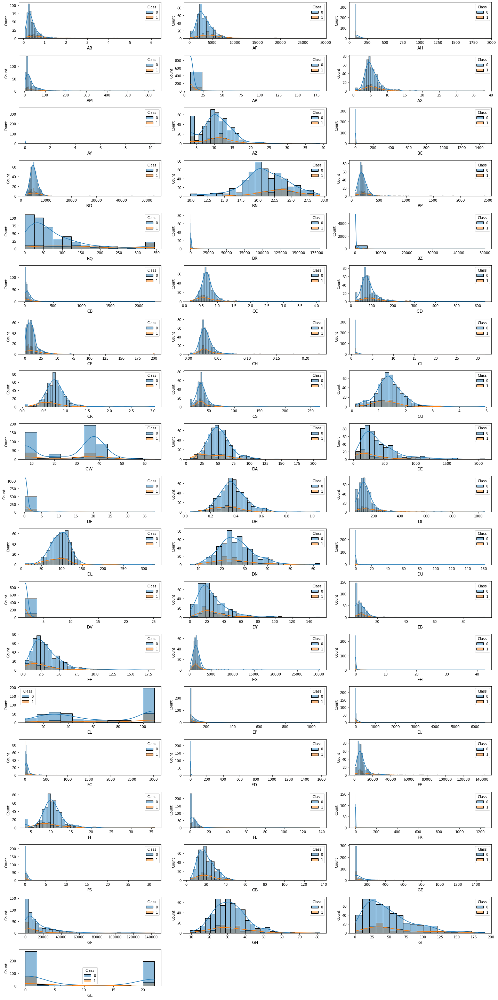

In [15]:
nrow = int((len(num_feat)/3) + len(num_feat)%3)

fig = plt.figure(figsize=(20,40))

for i, feature in enumerate(num_feat):
    ax = fig.add_subplot(nrow, 3, i+1)
    sns.histplot(data=train_df, x=feature, hue='Class', kde=True)
    ax.set_xlabel(feature, fontsize=12)

# Adjust the spacing between subplots
fig.tight_layout()

# Display the plot
plt.show()

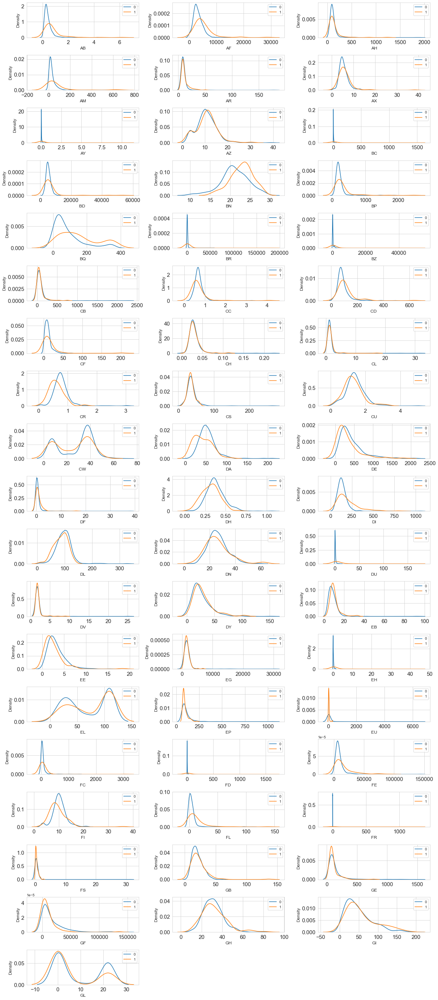

In [16]:
pdf_distribution_plots(df=train_df, features=num_feat, target='Class', fig_size=(20,50))
plt.show()

#### Boxplots

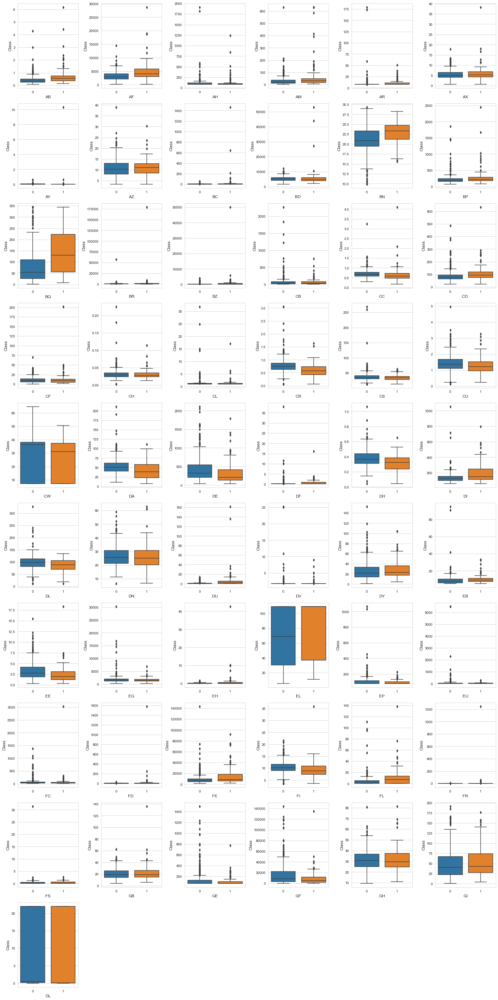

In [17]:
nrow = int((len(num_feat)/6) + len(num_feat)%6)

fig = plt.figure(figsize=(20,40))

for i, feature in enumerate(num_feat):
    ax = fig.add_subplot(nrow, 6, i+1)
    sns.boxplot(data=train_df, x="Class", y=feature)
    ax.set_xlabel(feature, fontsize=12)
    ax.set_ylabel("Class", fontsize=12)

# Adjust the spacing between subplots
fig.tight_layout()

# Display the plot
plt.show()

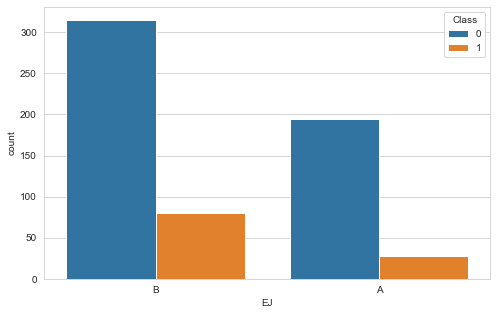

In [18]:
fig = plt.figure(figsize=(8,5))

sns.countplot(data=train_df, x="EJ", hue="Class")

plt.show()

### Multivariate Analysis

#### Pairplot

In [19]:
fig = plt.figure(figsize=(20,40))

sns.pairplot(data=train_df.drop(columns=['Id', 'EJ']), hue="Class", markers=["o", "D"])

plt.show()

<Figure size 1440x2880 with 0 Axes>